In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import silhouette_score
import plotly.express as plt

In [ ]:
# Specificando il percorso del file CSV
file_path = r'/content/drive/MyDrive/ESTRAZIONE_MAX_FILTER_TRANSFORMED.csv'

# Carico file CSV in un DataFrame
df = pd.read_csv(file_path)

In [ ]:
# Verifica delle date minime e massime
min_date = df['calendar_day'].min()
max_date = df['calendar_day'].max()

print(f"La data minima nel dataset è: {min_date}")
print(f"La data massima nel dataset è: {max_date}")

La data minima nel dataset è: 2018-01-01
La data massima nel dataset è: 2021-12-31


In [ ]:
#PRE PROCESSING DATI AGGIUNTIVA

# Rimuove i record con valori nulli nelle colonne chiave
df.dropna(subset=['partner_crm', 'speso', 'calendar_day'], inplace=True)

In [ ]:
# Aggregare i dati per cliente e scontrino
df_aggregated = df.groupby(['partner_crm', 'doc_number']).agg({
    'calendar_day': 'max',  # Data ultima transazione per scontrino
    'speso': 'sum'          # Totale speso per scontrino
}).reset_index()

# Aggiunta di una colonna temporanea per indicare le transazioni positive e negative
df_aggregated['transaction_count'] = df_aggregated['speso'].apply(lambda x: 1 if x > 0 else -1)


In [ ]:
# Calcolo del valore medio per cliente
df_customer_avg = df_aggregated.groupby('partner_crm').agg({
    'calendar_day': 'max',              # Data ultima transazione per cliente
    'transaction_count': 'sum',         # Conteggio delle transazioni (positivi e negativi)
    'speso': 'mean'                     # Valore medio degli acquisti per scontrino
}).reset_index()

In [ ]:

# Verifica delle date calcolate
print("Verifica delle date calcolate:")
for customer_id in df_customer_avg['partner_crm'].head(10):  # Mostra i primi 10 clienti per esempio
    original_dates = df[df['partner_crm'] == customer_id]['calendar_day']
    calculated_date = df_customer_avg[df_customer_avg['partner_crm'] == customer_id]['calendar_day'].values[0]
    print(f"Cliente {customer_id}: Data calcolata = {calculated_date}, Date originali = {original_dates.values}")

Verifica delle date calcolate:
Cliente 7: Data calcolata = 2018-10-03, Date originali = ['2018-10-03']
Cliente 10: Data calcolata = 2018-07-23, Date originali = ['2018-07-23']
Cliente 15: Data calcolata = 2021-02-24, Date originali = ['2018-05-31' '2018-05-31' '2021-02-24' '2019-05-30' '2019-05-30'
 '2019-05-30' '2019-05-28' '2019-05-30' '2019-05-28' '2019-05-28'
 '2018-05-31' '2018-04-11' '2018-05-31' '2018-05-31' '2018-05-31']
Cliente 94: Data calcolata = 2021-04-21, Date originali = ['2018-09-30' '2021-04-21' '2018-09-30' '2018-09-30' '2018-09-30']
Cliente 104: Data calcolata = 2019-01-07, Date originali = ['2019-01-07' '2018-01-09']
Cliente 138: Data calcolata = 2021-12-31, Date originali = ['2021-12-02' '2021-12-02' '2021-12-02' '2021-12-03' '2021-12-02'
 '2021-12-31' '2021-12-02' '2021-12-10' '2019-12-08' '2019-09-26'
 '2019-09-07' '2019-08-21' '2019-12-08' '2021-12-10' '2018-12-03'
 '2018-11-29' '2018-12-03' '2018-09-01' '2018-08-24' '2019-01-08'
 '2018-12-03' '2018-11-27' '2019

In [ ]:
# Rinominare le colonne
df_customer_avg.columns = ['partner_crm', 'LastPurchaseDate', 'Frequency', 'Monetary']

# Convertire la colonna 'LastPurchaseDate' in datetime
df_customer_avg['LastPurchaseDate'] = pd.to_datetime(df_customer_avg['LastPurchaseDate'])

# Calcolo della Recency
analysis_date = pd.to_datetime('2022-01-01')
df_customer_avg['Recency'] = (analysis_date - df_customer_avg['LastPurchaseDate']).dt.days

# Rimozione dei clienti con frequenza di acquisto pari a 0 o negativa
df_customer_avg = df_customer_avg[df_customer_avg['Frequency'] > 0]

print(df_customer_avg.head())

   partner_crm LastPurchaseDate  Frequency     Monetary  Recency
0            7       2018-10-03          1  1236.810677     1186
1           10       2018-07-23          1   212.427209     1258
2           15       2021-02-24          6  2501.830271      311
3           94       2021-04-21          3   730.958905      255
4          104       2019-01-07          2   364.456553     1090


In [ ]:
# Funzione per assegnare i punteggi RFM

def r_score(x, quintiles):
    if x <= quintiles[0.2]:
        return 5
    elif x <= quintiles[0.4]:
        return 4
    elif x <= quintiles[0.6]:
        return 3
    elif x <= quintiles[0.8]:
        return 2
    else:
        return 1

def fm_score_v2(x):
    if x == 1:
        return 1
    elif x == 2:
        return 2
    elif x <= 4:
        return 3
    elif x <= 8:
        return 4
    else:
        return 5

def m_score(x, quintiles):
    if x <= quintiles[0.2]:
        return 1
    elif x <= quintiles[0.4]:
        return 2
    elif x <= quintiles[0.6]:
        return 3
    elif x <= quintiles[0.8]:
        return 4
    else:
        return 5

# Calcolo dei quintili
recency_quintiles = df_customer_avg['Recency'].quantile([0.2, 0.4, 0.6, 0.8]).to_dict()
monetary_quintiles = df_customer_avg['Monetary'].quantile([0.2, 0.4, 0.6, 0.8]).to_dict()

# Assegnazione dei punteggi
df_customer_avg['R_Score'] = df_customer_avg['Recency'].apply(r_score, args=(recency_quintiles,))
df_customer_avg['F_Score'] = df_customer_avg['Frequency'].apply(fm_score_v2)
df_customer_avg['M_Score'] = df_customer_avg['Monetary'].apply(m_score, args=(monetary_quintiles,))

# Creazione del punteggio RFM
df_customer_avg['RFM_Score'] = df_customer_avg['R_Score'].astype(str) + df_customer_avg['F_Score'].astype(str) + df_customer_avg['M_Score'].astype(str)

print(df_customer_avg.head())

   partner_crm LastPurchaseDate  Frequency     Monetary  Recency  R_Score  \
0            7       2018-10-03          1  1236.810677     1186        1   
1           10       2018-07-23          1   212.427209     1258        1   
2           15       2021-02-24          6  2501.830271      311        4   
3           94       2021-04-21          3   730.958905      255        4   
4          104       2019-01-07          2   364.456553     1090        2   

   F_Score  M_Score RFM_Score  
0        1        5       115  
1        1        1       111  
2        4        5       445  
3        3        4       434  
4        2        2       222  


In [ ]:
import plotly.express as px

# Analisi dei segmenti
rfm_segments = df_customer_avg.groupby('RFM_Score').agg({
    'partner_crm': 'count',
    'Recency': 'mean',
    'Frequency': 'mean',
    'Monetary': 'mean'
}).reset_index()

rfm_segments.columns = ['RFM_Score', 'NumberOfCustomers', 'AvgRecency', 'AvgFrequency', 'AvgMonetary']

# Visualizzare tutti i risultati senza troncamenti
print(rfm_segments.to_string())

# Visualizzazione del grafico con Plotly Express
fig = px.bar(rfm_segments, x='RFM_Score', y='NumberOfCustomers',
             color='AvgMonetary',
             color_continuous_scale='Viridis',
             title='Number of Customers per RFM Segment',
             labels={'RFM_Score': 'RFM Segment', 'NumberOfCustomers': 'Number of Customers'},
             height=600)

fig.update_layout(
    xaxis_tickangle=-45,
    title_font_size=24,
    title_x=0.5,
    xaxis_title_font_size=18,
    yaxis_title_font_size=18,
    coloraxis_colorbar=dict(
        title='Avg Monetary Value',
        title_font_size=16,
        tickfont_size=14
    )
)

fig.show()


    RFM_Score  NumberOfCustomers   AvgRecency  AvgFrequency  AvgMonetary
0         111              32990  1273.442498      1.000000   224.825549
1         112              31402  1274.712248      1.000000   439.878951
2         113              37173  1280.764560      1.000000   617.497788
3         114              30992  1273.072858      1.000000   856.959955
4         115              36227  1276.420791      1.000000  1997.639134
5         121               3010  1252.845515      2.000000   241.070151
6         122               3966  1248.665658      2.000000   437.538662
7         123               3849  1248.850351      2.000000   617.849920
8         124               4124  1245.253880      2.000000   880.941640
9         125               5066  1244.583498      2.000000  1860.847340
10        131                497  1237.511066      3.146881   248.725458
11        132                831  1230.762936      3.187726   440.505655
12        133                935  1222.394652      

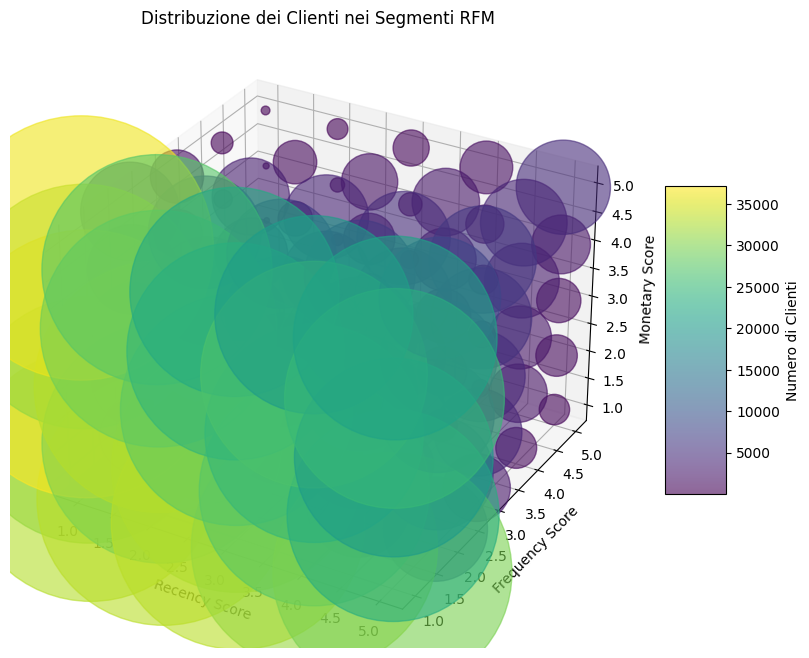

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from mpl_toolkits.mplot3d import Axes3D

# Supponiamo che df_customer_avg sia il DataFrame contenente i dati RFM

# Creare una nuova colonna con il numero di clienti per ogni combinazione di punteggi RFM
rfm_counts = df_customer_avg.groupby(['R_Score', 'F_Score', 'M_Score']).size().reset_index(name='Count')

# Scatter plot 3D
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Creare il grafico a dispersione
sc = ax.scatter(rfm_counts['R_Score'], rfm_counts['F_Score'], rfm_counts['M_Score'], s=rfm_counts['Count'], alpha=0.6, c=rfm_counts['Count'], cmap='viridis')

# Aggiungere etichette e titolo
ax.set_xlabel('Recency Score')
ax.set_ylabel('Frequency Score')
ax.set_zlabel('Monetary Score')
plt.title('Distribuzione dei Clienti nei Segmenti RFM')

# Aggiungere barra colore
cbar = plt.colorbar(sc, ax=ax, shrink=0.5, aspect=5)
cbar.set_label('Numero di Clienti')

plt.show()

In [ ]:
import plotly.express as px

# Supponiamo che df_customer_avg sia il DataFrame contenente i dati RFM

# Creare una nuova colonna con il numero di clienti per ogni combinazione di punteggi RFM
rfm_counts = df_customer_avg.groupby(['R_Score', 'F_Score', 'M_Score']).size().reset_index(name='Count')

# Creare il grafico a dispersione 3D
fig = px.scatter_3d(rfm_counts, x='R_Score', y='F_Score', z='M_Score',
                    size='Count', color='Count', opacity=0.6,
                    color_continuous_scale='Viridis')

# Aggiungere etichette e titolo
fig.update_layout(title='Distribuzione dei Clienti nei Segmenti RFM',
                  scene = dict(
                    xaxis_title='Recency Score',
                    yaxis_title='Frequency Score',
                    zaxis_title='Monetary Score'))

fig.show()


In [ ]:
# Controllo della distribuzione delle frequenze
frequency_distribution = df_customer_avg['Frequency'].value_counts().sort_index()
print(frequency_distribution)

Frequency
1       712892
2       147438
3        50283
4        22826
5        12033
         ...  
387          1
439          1
911          1
1596         1
2425         1
Name: count, Length: 147, dtype: int64


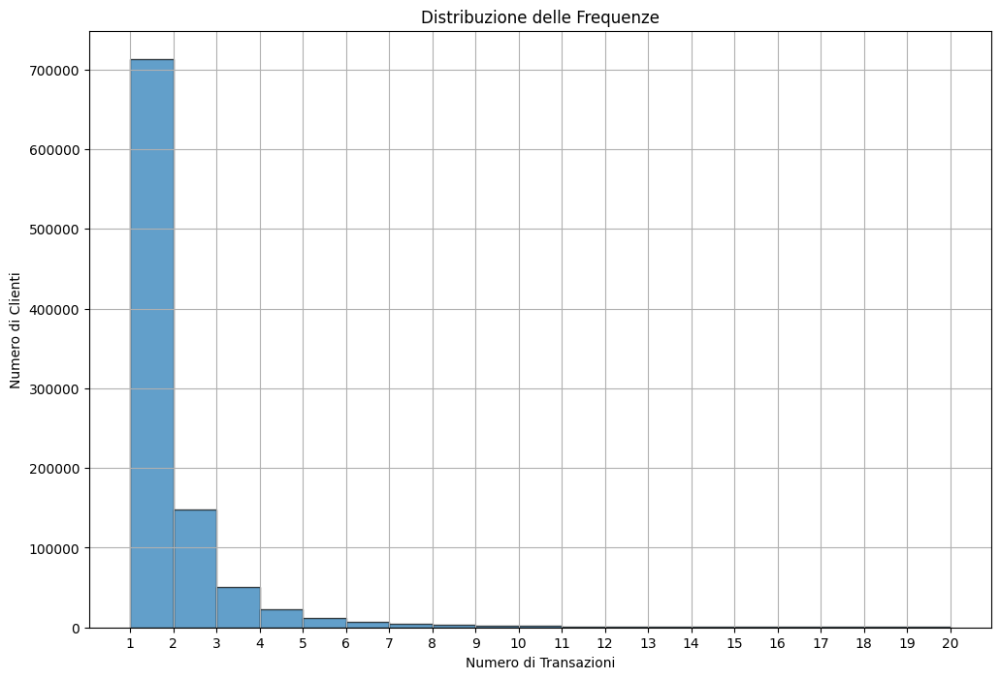

In [ ]:
import matplotlib.pyplot as plt

# Istogramma delle frequenze
plt.figure(figsize=(12, 8))
plt.hist(df_customer_avg['Frequency'], bins=range(1, 21), edgecolor='k', alpha=0.7)
plt.title('Distribuzione delle Frequenze')
plt.xlabel('Numero di Transazioni')
plt.ylabel('Numero di Clienti')
plt.xticks(range(1, 21))
plt.grid(True)
plt.show()

In [ ]:
# Creazione del grafico a barre con Plotly Express
fig = px.bar(rfm_segments,
             x='RFM_Score',
             y='AvgRecency',
             color='AvgMonetary',  # Cambiato da 'AvgRecency' a 'AvgMonetary'
             color_continuous_scale='Viridis',
             title='Average Recency per RFM Segment',
             labels={'RFM_Score': 'RFM Segment', 'AvgRecency': 'Average Recency'})


fig.update_layout(
    title_font_size=20,
    xaxis_title='RFM Segment',
    yaxis_title='Average Recency',
    xaxis_tickangle=-45,
    coloraxis_colorbar=dict(title='Average Monetary')  # Cambiato il titolo della barra colorata
)


fig.show()



In [ ]:
# Creazione del grafico a barre con Plotly Express
fig = px.bar(rfm_segments,
             x='RFM_Score',
             y='AvgFrequency',
             color='AvgMonetary',  # Cambiato da 'AvgFrequency' a 'AvgMonetary'
             color_continuous_scale='Viridis',
             title='Average Frequency per RFM Segment',
             labels={'RFM_Score': 'RFM Segment', 'AvgFrequency': 'Average Frequency'})


fig.update_layout(
    title_font_size=20,
    xaxis_title='RFM Segment',
    yaxis_title='Average Frequency',
    xaxis_tickangle=-45,
    coloraxis_colorbar=dict(title='Average Monetary')  # Cambiato il titolo della barra colorata
)


fig.show()


In [ ]:
# Creazione del grafico a barre con Plotly Express
fig = px.bar(rfm_segments,
             x='RFM_Score',
             y='AvgMonetary',
             color='AvgMonetary',
             color_continuous_scale='Viridis',
             title='Average Monetary Value per RFM Segment',
             labels={'RFM_Score': 'RFM Segment', 'AvgMonetary': 'Average Monetary Value'})


fig.update_layout(
    title_font_size=20,
    xaxis_title='RFM Segment',
    yaxis_title='Average Monetary Value',
    xaxis_tickangle=-45,
    coloraxis_colorbar=dict(title='Average Monetary Value')
)


fig.show()


In [ ]:
# Creazione tabella pivot per heatmap
heatmap_data = rfm_segments.pivot_table(index='AvgFrequency', columns='AvgMonetary', values='AvgRecency', aggfunc='mean')

# Reset dell'indice per permettere la conversione in un DataFrame utilizzabile da Plotly Express
heatmap_data = heatmap_data.reset_index().melt(id_vars='AvgFrequency', var_name='AvgMonetary', value_name='AvgRecency')

# Creazione della heatmap con Plotly Express
fig = px.density_heatmap(
    heatmap_data,
    x='AvgMonetary',
    y='AvgFrequency',
    z='AvgRecency',
    color_continuous_scale='YlGnBu',
    title='Heatmap of AvgRecency, AvgFrequency, and AvgMonetary'
)

# Miglioramento delle etichette e del layout
fig.update_layout(
    title_font_size=20,
    xaxis_title='AvgMonetary',
    yaxis_title='AvgFrequency',
    coloraxis_colorbar=dict(title='AvgRecency')
)


fig.show()

In [ ]:
# Aggregare i dati per il grafico
df_customer_total = df_customer_avg.groupby('RFM_Score').agg({
    'Monetary': 'sum',
    'Frequency': 'sum'
}).reset_index()

fig = px.bar(df_customer_total, x='RFM_Score', y='Monetary', color='Monetary',
             color_continuous_scale='viridis', title='Total Monetary Value per RFM Segment')

fig.update_layout(
    title='Total Monetary Value per RFM Segment',
    xaxis_title='RFM Segment',
    yaxis_title='Total Monetary Value',
    xaxis=dict(tickmode='linear'),
    template='plotly'
)

fig.show()


In [ ]:
# Calcolo dei quintili, dimostra l'errore precedentemente riscontrato nei quintili della Frequency
recency_quintiles = df_customer_avg['Recency'].quantile([0.2, 0.4, 0.6, 0.8])
frequency_quintiles = df_customer_avg['Frequency'].quantile([0.2, 0.4, 0.6, 0.8])
monetary_quintiles = df_customer_avg['Monetary'].quantile([0.2, 0.4, 0.6, 0.8])

# Visualizzazione dei quintili

print("Quintili della Recency:")
print(recency_quintiles)

print("\nQuintili della Frequency:")
print(frequency_quintiles)

print("\nQuintili della Monetary:")
print(monetary_quintiles)

Quintili della Recency:
0.2     178.0
0.4     426.0
0.6     788.0
0.8    1091.0
Name: Recency, dtype: float64

Quintili della Frequency:
0.2    1.0
0.4    1.0
0.6    1.0
0.8    2.0
Name: Frequency, dtype: float64

Quintili della Monetary:
0.2     341.990969
0.4     528.310862
0.6     720.289162
0.8    1085.481106
Name: Monetary, dtype: float64


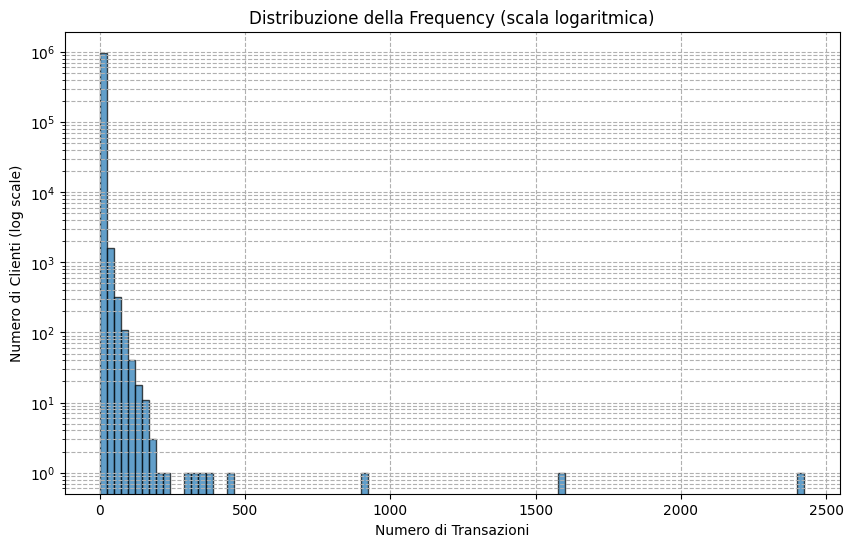

In [ ]:
#Risultati dubbi della frequency, maggior parte dei clienti 1 acquisto (vedere i percentili)
# Istogramma della Frequency con scala logaritmica
plt.figure(figsize=(10, 6))
plt.hist(df_customer_avg['Frequency'], bins=100, edgecolor='k', alpha=0.7, log=True)
plt.title('Distribuzione della Frequency (scala logaritmica)')
plt.xlabel('Numero di Transazioni')
plt.ylabel('Numero di Clienti (log scale)')
plt.yscale('log')
plt.grid(True, which="both", ls="--")
plt.show()

/usr/local/lib/python3.10/dist-packages/matplotlib/collections.py:963: RuntimeWarning:

invalid value encountered in sqrt



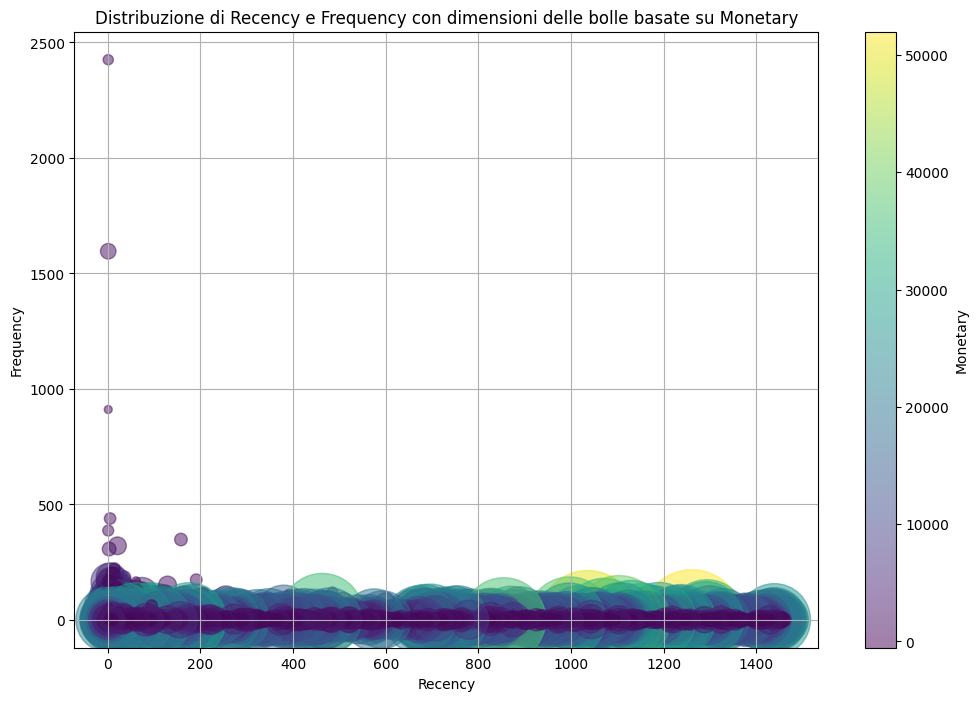

In [ ]:
# Calcolo delle dimensioni delle bolle (Monetary come esempio)
bubble_size = df_customer_avg['Monetary'] / 10  # Riduzione dimensione bolle per migliore visualizzazione

# Creazione del grafico a bolle
plt.figure(figsize=(12, 8))
plt.scatter(df_customer_avg['Recency'], df_customer_avg['Frequency'], s=bubble_size, alpha=0.5, c=df_customer_avg['Monetary'], cmap='viridis')
plt.title('Distribuzione di Recency e Frequency con dimensioni delle bolle basate su Monetary')
plt.xlabel('Recency')
plt.ylabel('Frequency')
plt.colorbar(label='Monetary')
plt.grid(True)
plt.show()

In [ ]:
# Creazione della heatmap v2
heatmap_data = df_customer_avg.pivot_table(index='R_Score', columns='F_Score', values='Monetary', aggfunc='mean').reset_index()

fig = px.imshow(heatmap_data.set_index('R_Score'),
                labels=dict(x="Frequency Score", y="Recency Score", color="Average Monetary"),
                x=heatmap_data.columns[1:],  # Escludere la colonna 'R_Score' dall'asse x
                y=heatmap_data['R_Score'],
                color_continuous_scale='YlGnBu',
                aspect="auto")

fig.update_layout(
    title='Heatmap della media del valore Monetary basata sui punteggi Recency e Frequency'
)

fig.show()


In [ ]:
# Selezione delle colonne per il pairplot
pairplot_data = df_customer_avg[['Recency', 'Frequency', 'Monetary']]

# Creazione del pairplot
fig = px.scatter_matrix(pairplot_data,
                        dimensions=['Recency', 'Frequency', 'Monetary'],
                        title='Pairplot delle variabili Recency, Frequency e Monetary',
                        labels={'Recency': 'Recency', 'Frequency': 'Frequency', 'Monetary': 'Monetary'})

fig.update_layout(
    width=800,
    height=800,
    dragmode='select',
    hovermode='closest'
)

fig.show()


In [ ]:
#QUERY PER INDAGARE LA DISTRIBUZIONE DELLA FREQUENZA DEGLI ACQUISTI IN MODO TALE DA RIFARE I QUINTILI DELLA F NEL RFM SCORE


In [ ]:
# Calcolando le statistiche di base sulla frequenza
frequency_stats = df_customer_avg['Frequency'].describe()
print(frequency_stats)

count    974912.000000
mean          1.711630
std           4.238813
min           1.000000
25%           1.000000
50%           1.000000
75%           2.000000
max        2425.000000
Name: Frequency, dtype: float64


In [ ]:
# Calcolando i percentili della frequenza
frequency_percentiles = df_customer_avg['Frequency'].quantile([0.01, 0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99])
print(frequency_percentiles)

0.01     1.0
0.05     1.0
0.10     1.0
0.25     1.0
0.50     1.0
0.75     2.0
0.90     3.0
0.95     4.0
0.99    11.0
Name: Frequency, dtype: float64


In [ ]:
# Contare il numero di clienti per ciascuna frequenza di acquisto fra 0 e 20
frequency_range = range(0, 41)
frequency_counts = df_customer_avg[df_customer_avg['Frequency'].isin(frequency_range)]['Frequency'].value_counts().sort_index()
print(frequency_counts)

Frequency
1     712892
2     147438
3      50283
4      22826
5      12033
6       7423
7       4792
8       3326
9       2345
10      1777
11      1382
12      1129
13       886
14       735
15       598
16       506
17       442
18       356
19       297
20       315
21       246
22       221
23       206
24       185
25       178
26       162
27       135
28       130
29       104
30        99
31        89
32        85
33        80
34        83
35        73
36        44
37        58
38        43
39        42
40        45
Name: count, dtype: int64


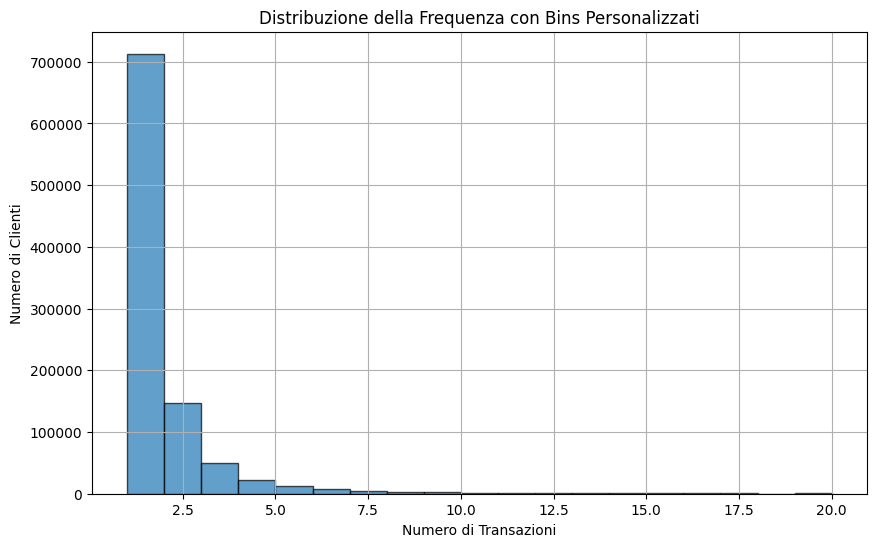

In [ ]:
# Istogramma della frequenza con bins personalizzati
plt.figure(figsize=(10, 6))
plt.hist(df_customer_avg['Frequency'], bins=range(1, 21), edgecolor='k', alpha=0.7)
plt.title('Distribuzione della Frequenza con Bins Personalizzati')
plt.xlabel('Numero di Transazioni')
plt.ylabel('Numero di Clienti')
plt.grid(True)
plt.show()

In [ ]:
# Unire con le informazioni geografiche
df_geo = df[['partner_crm', 'country_cli']].drop_duplicates()
df_customer_geo = pd.merge(df_customer_avg, df_geo, on='partner_crm')

# Analisi per paese con RFM score alti
df_geo_high = df_customer_geo[
    (df_customer_geo['R_Score'] >= 4) &
    (df_customer_geo['F_Score'] >= 4) &
    (df_customer_geo['M_Score'] >= 4)
]

# Analisi per paese con RFM score bassi
df_geo_low = df_customer_geo[
    (df_customer_geo['R_Score'] <= 2) &
    (df_customer_geo['F_Score'] <= 2) &
    (df_customer_geo['M_Score'] <= 2)
]

# Contare i clienti per paese con punteggi RFM alti
high_score_counts = df_geo_high['country_cli'].value_counts().reset_index(name='Count')
high_score_counts.columns = ['Country', 'Count']

# Contare i clienti per paese con punteggi RFM bassi
low_score_counts = df_geo_low['country_cli'].value_counts().reset_index(name='Count')
low_score_counts.columns = ['Country', 'Count']

# Migliori 20 paesi
top_20_high_score_countries = high_score_counts.head(20)
print("Migliori 20 paesi per punteggi RFM alti:")
print(top_20_high_score_countries)

# Peggiori 20 paesi
top_20_low_score_countries = low_score_counts.head(20)
print("Peggiori 20 paesi per punteggi RFM bassi:")
print(top_20_low_score_countries)

# Analisi dei paesi con il valore monetario più alto e più basso
# Calcolo della media del valore monetario e della frequenza per paese
df_geo_summary = df_customer_geo.groupby('country_cli').agg({
    'Monetary': 'mean',
    'Frequency': 'mean'
}).reset_index()

# Ordinamento per valore monetario
df_geo_summary_sorted_monetary = df_geo_summary.sort_values(by='Monetary', ascending=False)

# Top 10 paesi per valore monetario
top_10_monetary_countries = df_geo_summary_sorted_monetary.head(10)
print("Top 10 paesi per valore monetario:")
print(top_10_monetary_countries)

# Ultimi 10 paesi per valore monetario
last_10_monetary_countries = df_geo_summary_sorted_monetary.tail(10)
print("Ultimi 10 paesi per valore monetario:")
print(last_10_monetary_countries)

# Ordinamento per frequenza
df_geo_summary_sorted_frequency = df_geo_summary.sort_values(by='Frequency', ascending=False)

# Top 10 paesi per frequenza
top_10_frequency_countries = df_geo_summary_sorted_frequency.head(10)
print("Top 10 paesi per frequenza:")
print(top_10_frequency_countries)

# Ultimi 10 paesi per frequenza
last_10_frequency_countries = df_geo_summary_sorted_frequency.tail(10)
print("Ultimi 10 paesi per frequenza:")
print(last_10_frequency_countries)



Migliori 20 paesi per punteggi RFM alti:
   Country  Count
0       CN   5295
1       JP   2998
2       US   2370
3       HK   1090
4       BR    947
5       KR    882
6       IT    783
7       AE    661
8       TW    394
9       FR    394
10      DE    324
11      GB    321
12      SG    277
13      CH    274
14      MC    221
15      ES    212
16      SA    195
17      MX    189
18      MO    146
19      AU    143
Peggiori 20 paesi per punteggi RFM bassi:
   Country  Count
0       CN  26086
1       US  16539
2       KR  15486
3       JP  13328
4       FR   8351
5       IT   8161
6       GB   5223
7       AE   4206
8       HK   3967
9       RU   2858
10      AU   2722
11      DE   2580
12      SA   2194
13      BR   2103
14      KW   1903
15      SG   1903
16      DK   1829
17      QA   1549
18      CA   1312
19      TW   1126
Top 10 paesi per valore monetario:
    country_cli     Monetary  Frequency
210          ST  2840.589340   5.000000
67           EH  2532.854690   1.000000
207   

In [ ]:
# Calcolo della media del valore monetario e della frequenza per paese
df_geo_summary = df_customer_geo.groupby('country_cli').agg({
    'Monetary': 'mean',
    'Frequency': 'mean'
}).reset_index()

# Ordinamento per valore monetario
df_geo_summary_sorted_monetary = df_geo_summary.sort_values(by='Monetary', ascending=False)

# Top 10 paesi per valore monetario
top_10_monetary_countries = df_geo_summary_sorted_monetary.head(10)
print("Top 10 paesi per valore monetario:")
print(top_10_monetary_countries)

# Ultimi 10 paesi per valore monetario
last_10_monetary_countries = df_geo_summary_sorted_monetary.tail(10)
print("Ultimi 10 paesi per valore monetario:")
print(last_10_monetary_countries)

# Ordinamento per frequenza
df_geo_summary_sorted_frequency = df_geo_summary.sort_values(by='Frequency', ascending=False)

# Top 10 paesi per frequenza
top_10_frequency_countries = df_geo_summary_sorted_frequency.head(10)
print("Top 10 paesi per frequenza:")
print(top_10_frequency_countries)

# Ultimi 10 paesi per frequenza
last_10_frequency_countries = df_geo_summary_sorted_frequency.tail(10)
print("Ultimi 10 paesi per frequenza:")
print(last_10_frequency_countries)

Top 10 paesi per valore monetario:
    country_cli     Monetary  Frequency
210          ST  2840.589340   5.000000
67           EH  2532.854690   1.000000
207          SO  1760.451120   1.000000
133          LR  1716.305137   1.250000
249          ZW  1671.595601   2.722222
177          PG  1590.859051   1.000000
242          VU  1481.507269   1.055556
181          PM  1434.819046   2.000000
45           CK  1398.618960   1.500000
222          TM  1342.840417   2.458333
Ultimi 10 paesi per valore monetario:
    country_cli    Monetary  Frequency
60           DK  519.108797   1.419138
112          IT  518.149994   2.010313
51           CS  497.403792   1.000000
106          IM  471.489112   1.000000
15           AX  443.275303   1.166667
77           FX  410.811802   1.190476
246          YT  402.608657   1.000000
186          PW  355.466326   1.000000
244          WS  286.823642   1.000000
170          NR  282.244367   1.000000
Top 10 paesi per frequenza:
    country_cli     Monetary  

In [ ]:
# Unire con le informazioni demografiche
df_geo = df[['partner_crm', 'country_cli', 'age', 'XSEXU']].drop_duplicates()
df_customer_geo = pd.merge(df_customer_avg, df_geo, on='partner_crm')

# Filtrare i dati per i segmenti RFM più alti
df_high_rfm = df_customer_geo[
    (df_customer_geo['R_Score'] >= 4) &
    (df_customer_geo['F_Score'] >= 4) &
    (df_customer_geo['M_Score'] >= 4)
]

# Distribuzione percentuale delle categorie di età
age_distribution = df_high_rfm['age'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle categorie di età:")
print(age_distribution)

# Distribuzione percentuale per genere
gender_distribution = df_high_rfm['XSEXU'].value_counts(normalize=True) * 100
print("Distribuzione percentuale per genere:")
print(gender_distribution)

# Distribuzione percentuale per paese
country_distribution = df_high_rfm['country_cli'].value_counts(normalize=True) * 100
print("Distribuzione percentuale per paese:")
print(country_distribution)

# Distribuzione percentuale delle tipologie di prodotti più acquistate
product_distribution = df[df['partner_crm'].isin(df_high_rfm['partner_crm'])]['LINE_RECLASS_3_DESC'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle tipologie di prodotti più acquistate:")
print(product_distribution)

# Distribuzione percentuale degli acquisti tra i vari canali
channel_distribution = df[df['partner_crm'].isin(df_high_rfm['partner_crm'])]['afs_channel'].value_counts(normalize=True) * 100
print("Distribuzione percentuale degli acquisti tra i vari canali:")
print(channel_distribution)



Distribuzione percentuale delle categorie di età:
age
Z003    30.244348
Z004    29.590388
Z005    18.670790
Z002    11.208557
Z006     9.104735
Z001     1.181182
Name: proportion, dtype: float64
Distribuzione percentuale per genere:
XSEXU
F    67.053423
U    19.618625
M    13.327952
Name: proportion, dtype: float64
Distribuzione percentuale per paese:
country_cli
CN    26.711396
JP    15.123846
US    11.955809
HK     5.498663
BR     4.777279
        ...    
BA     0.005045
ML     0.005045
TJ     0.005045
GY     0.005045
BS     0.005045
Name: proportion, Length: 147, dtype: float64
Distribuzione percentuale delle tipologie di prodotti più acquistate:
LINE_RECLASS_3_DESC
WOMAN       78.890641
MAN         19.282809
LICENSES     1.826550
Name: proportion, dtype: float64
Distribuzione percentuale degli acquisti tra i vari canali:
afs_channel
DG    89.204356
FG     9.293791
WS     1.425843
VG     0.076010
Name: proportion, dtype: float64


In [ ]:
#Distribuzione delle Categorie di Prodotti Più Vendute

# Unire con le informazioni demografiche
df_geo = df[['partner_crm', 'country_cli', 'age', 'XSEXU']].drop_duplicates()
df_customer_geo = pd.merge(df_customer_avg, df_geo, on='partner_crm')

# Filtrare i dati per i segmenti RFM più alti
df_high_rfm = df_customer_geo[
    (df_customer_geo['R_Score'] >= 4) &
    (df_customer_geo['F_Score'] >= 4) &
    (df_customer_geo['M_Score'] >= 4)
]

# Distribuzione percentuale delle tipologie di prodotti più acquistate
product_distribution_high_rfm = df[df['partner_crm'].isin(df_high_rfm['partner_crm'])]['LINE_RECLASS_3_DESC'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle tipologie di prodotti più acquistate per i clienti con punteggi RFM alti:")
print(product_distribution_high_rfm)

# Filtrare i dati per i segmenti RFM più bassi
df_low_rfm = df_customer_geo[
    (df_customer_geo['R_Score'] <= 2) &
    (df_customer_geo['F_Score'] <= 2) &
    (df_customer_geo['M_Score'] <= 2)
]

# Distribuzione percentuale delle tipologie di prodotti più acquistate
product_distribution_low_rfm = df[df['partner_crm'].isin(df_low_rfm['partner_crm'])]['LINE_RECLASS_3_DESC'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle tipologie di prodotti più acquistate per i clienti con punteggi RFM bassi:")
print(product_distribution_low_rfm)

Distribuzione percentuale delle tipologie di prodotti più acquistate per i clienti con punteggi RFM alti:
LINE_RECLASS_3_DESC
WOMAN       78.890641
MAN         19.282809
LICENSES     1.826550
Name: proportion, dtype: float64
Distribuzione percentuale delle tipologie di prodotti più acquistate per i clienti con punteggi RFM bassi:
LINE_RECLASS_3_DESC
WOMAN       66.929017
MAN         25.932345
LICENSES     7.138639
Name: proportion, dtype: float64


In [ ]:
#Distribuzione delle Categorie di Prodotti per Canale di Vendita

# Distribuzione percentuale delle tipologie di prodotti per canale di vendita per i clienti con punteggi RFM alti
channel_product_distribution_high_rfm = df[df['partner_crm'].isin(df_high_rfm['partner_crm'])].groupby('afs_channel')['LINE_RECLASS_3_DESC'].value_counts(normalize=True).unstack().fillna(0) * 100
print("Distribuzione percentuale delle tipologie di prodotti per canale di vendita per i clienti con punteggi RFM alti:")
print(channel_product_distribution_high_rfm)

# Distribuzione percentuale delle tipologie di prodotti per canale di vendita per i clienti con punteggi RFM bassi
channel_product_distribution_low_rfm = df[df['partner_crm'].isin(df_low_rfm['partner_crm'])].groupby('afs_channel')['LINE_RECLASS_3_DESC'].value_counts(normalize=True).unstack().fillna(0) * 100
print("Distribuzione percentuale delle tipologie di prodotti per canale di vendita per i clienti con punteggi RFM bassi:")
print(channel_product_distribution_low_rfm)

Distribuzione percentuale delle tipologie di prodotti per canale di vendita per i clienti con punteggi RFM alti:
LINE_RECLASS_3_DESC  LICENSES        MAN      WOMAN
afs_channel                                        
DG                   1.986982  18.971682  79.041336
FG                   0.287993  22.570913  77.141094
VG                   1.315789  16.052632  82.631579
WS                   1.574574  18.063858  80.361569
Distribuzione percentuale delle tipologie di prodotti per canale di vendita per i clienti con punteggi RFM bassi:
LINE_RECLASS_3_DESC  LICENSES        MAN      WOMAN
afs_channel                                        
DG                   8.199566  24.446855  67.353579
FG                   0.498446  28.423151  71.078403
VG                   4.109589  19.178082  76.712329
WS                   3.118974  41.359940  55.521087


In [ ]:
#Distribuzione delle Categorie di Prodotti per Paese

# Distribuzione percentuale delle tipologie di prodotti per paese per i clienti con punteggi RFM alti
country_product_distribution_high_rfm = df[df['partner_crm'].isin(df_high_rfm['partner_crm'])].groupby('country_cli')['LINE_RECLASS_3_DESC'].value_counts(normalize=True).unstack().fillna(0) * 100
print("Distribuzione percentuale delle tipologie di prodotti per paese per i clienti con punteggi RFM alti:")
print(country_product_distribution_high_rfm)

# Distribuzione percentuale delle tipologie di prodotti per paese per i clienti con punteggi RFM bassi
country_product_distribution_low_rfm = df[df['partner_crm'].isin(df_low_rfm['partner_crm'])].groupby('country_cli')['LINE_RECLASS_3_DESC'].value_counts(normalize=True).unstack().fillna(0) * 100
print("Distribuzione percentuale delle tipologie di prodotti per paese per i clienti con punteggi RFM bassi:")
print(country_product_distribution_low_rfm)

Distribuzione percentuale delle tipologie di prodotti per paese per i clienti con punteggi RFM alti:
LINE_RECLASS_3_DESC  LICENSES        MAN       WOMAN
country_cli                                         
AD                   4.464286   1.785714   93.750000
AE                   3.935903  15.359622   80.704475
AL                   1.809955  33.031674   65.158371
AM                   4.046243   1.734104   94.219653
AN                   0.000000   0.000000  100.000000
...                       ...        ...         ...
VI                   0.000000   0.000000  100.000000
VN                   0.000000   3.278689   96.721311
YE                   0.000000   9.090909   90.909091
ZA                   3.071672  59.385666   37.542662
ZW                   4.545455  72.727273   22.727273

[147 rows x 3 columns]
Distribuzione percentuale delle tipologie di prodotti per paese per i clienti con punteggi RFM bassi:
LINE_RECLASS_3_DESC   LICENSES         MAN       WOMAN
country_cli                  

In [ ]:
# Creazione del grafico a barre per la distribuzione delle categorie di prodotti per i clienti con punteggi RFM alti
product_distribution_high_rfm = product_distribution_high_rfm.reset_index()
product_distribution_high_rfm.columns = ['Categoria di Prodotto', 'Percentuale']

fig = px.bar(product_distribution_high_rfm,
             x='Categoria di Prodotto',
             y='Percentuale',
             title='Distribuzione delle Categorie di Prodotti per i Clienti con Punteggi RFM Alti',
             labels={'Categoria di Prodotto': 'Categoria di Prodotto', 'Percentuale': 'Percentuale'},
             height=400)

fig.show()

In [ ]:
# Unire con le informazioni demografiche
df_geo = df[['partner_crm', 'country_cli', 'age', 'XSEXU']].drop_duplicates()
df_customer_geo = pd.merge(df_customer_avg, df_geo, on='partner_crm')

# Filtrare i dati per i segmenti RFM più alti
df_high_rfm = df_customer_geo[
    (df_customer_geo['R_Score'] >= 4) &
    (df_customer_geo['F_Score'] >= 4) &
    (df_customer_geo['M_Score'] >= 4)
]

# Distribuzione percentuale per LEV1B_DESC
product_distribution_lev1b = df[df['partner_crm'].isin(df_high_rfm['partner_crm'])]['LEV1B_DESC'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle categorie di prodotti (LEV1B_DESC) per i clienti con punteggi RFM alti:")
print(product_distribution_lev1b)

# Distribuzione percentuale per LEV2A_DESC
product_distribution_lev2a = df[df['partner_crm'].isin(df_high_rfm['partner_crm'])]['LEV2A_DESC'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle categorie di prodotti (LEV2A_DESC) per i clienti con punteggi RFM alti:")
print(product_distribution_lev2a)

# Distribuzione percentuale per LEV3_DESC
product_distribution_lev3 = df[df['partner_crm'].isin(df_high_rfm['partner_crm'])]['LEV3_DESC'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle categorie di prodotti (LEV3_DESC) per i clienti con punteggi RFM alti:")
print(product_distribution_lev3)


# Creazione del grafico a barre per la distribuzione delle categorie di prodotti LEV1B_DESC
fig_lev1b = px.bar(product_distribution_lev1b.reset_index(), x='index', y='LEV1B_DESC',
                   title='Distribuzione delle Categorie di Prodotti (LEV1B_DESC) per i Clienti con Punteggi RFM Alti',
                   labels={'index': 'Categoria di Prodotto', 'LEV1B_DESC': 'Percentuale'},
                   height=400)
fig_lev1b.show()

# Creazione del grafico a barre per la distribuzione delle categorie di prodotti LEV2A_DESC
fig_lev2a = px.bar(product_distribution_lev2a.reset_index(), x='index', y='LEV2A_DESC',
                   title='Distribuzione delle Categorie di Prodotti (LEV2A_DESC) per i Clienti con Punteggi RFM Alti',
                   labels={'index': 'Categoria di Prodotto', 'LEV2A_DESC': 'Percentuale'},
                   height=400)
fig_lev2a.show()

# Creazione del grafico a barre per la distribuzione delle categorie di prodotti LEV3_DESC
fig_lev3 = px.bar(product_distribution_lev3.reset_index(), x='index', y='LEV3_DESC',
                   title='Distribuzione delle Categorie di Prodotti (LEV3_DESC) per i Clienti con Punteggi RFM Alti',
                   labels={'index': 'Categoria di Prodotto', 'LEV3_DESC': 'Percentuale'},
                   height=400)
fig_lev3.show()

Distribuzione percentuale delle categorie di prodotti (LEV1B_DESC) per i clienti con punteggi RFM alti:
LEV1B_DESC
APPAREL                53.097040
SHOES                  25.542037
LARGE LEATHER GOODS    10.832836
SMALL LEATHER GOODS     3.279329
BELTS                   2.203877
FASHION JEWELRY         1.974951
LICENCES                1.604972
SOFT ACCESSORIES        1.464958
Name: proportion, dtype: float64
Distribuzione percentuale delle categorie di prodotti (LEV2A_DESC) per i clienti con punteggi RFM alti:
LEV2A_DESC
SHOES                                      25.542037
JERSEY                                     13.551277
HANDBAGS                                   10.832629
ABITI DONNA + TUTE                          9.522642
KNITWEAR                                    8.354332
CAPISPALLA + OUTERWEAR + CAPI IMBOTTITI     7.063665
BOTTOMS                                     6.062790
CAMICIE/TOP                                 5.400526
SLG                                         3.279

ValueError: Value of 'x' is not the name of a column in 'data_frame'. Expected one of ['LEV1B_DESC', 'proportion'] but received: index
 To use the index, pass it in directly as `df.index`.

In [ ]:
# Caricamento del  file CSV in un DataFrame per ottenere le informazoni transazionali originali
file_path = r'/content/drive/MyDrive/ESTRAZIONE_MAX_FILTER_TRANSFORMED.csv'
df = pd.read_csv(file_path)

# Unire con le informazioni demografiche
df_geo = df[['partner_crm', 'country_cli', 'age', 'XSEXU']].drop_duplicates()
df_customer_geo = pd.merge(df_customer_avg, df_geo, on='partner_crm')

# Filtrare i dati per i segmenti RFM più alti
df_high_rfm = df_customer_geo[
    (df_customer_geo['R_Score'] >= 4) &
    (df_customer_geo['F_Score'] >= 4) &
    (df_customer_geo['M_Score'] >= 4)
]

# Distribuzione percentuale per età
age_distribution_high_rfm = df_high_rfm['age'].value_counts(normalize=True).reset_index()
age_distribution_high_rfm.columns = ['Categoria_Prodotto', 'Proportion']
print("Distribuzione percentuale delle categorie di età per i clienti con punteggi RFM alti:")
print(age_distribution_high_rfm)

# Distribuzione percentuale per genere
gender_distribution_high_rfm = df_high_rfm['XSEXU'].value_counts(normalize=True).reset_index()
gender_distribution_high_rfm.columns = ['Genere', 'Proportion']
print("Distribuzione percentuale per genere per i clienti con punteggi RFM alti:")
print(gender_distribution_high_rfm)

# Distribuzione percentuale per paese
country_distribution_high_rfm = df_high_rfm['country_cli'].value_counts(normalize=True).reset_index()
country_distribution_high_rfm.columns = ['Paese', 'Proportion']
print("Distribuzione percentuale per paese per i clienti con punteggi RFM alti:")
print(country_distribution_high_rfm)

# Distribuzione percentuale delle tipologie di prodotti più acquistate (LINE_RECLASS_3_DESC)
product_distribution_high_rfm = df[df['partner_crm'].isin(df_high_rfm['partner_crm'])]['LINE_RECLASS_3_DESC'].value_counts(normalize=True).reset_index()
product_distribution_high_rfm.columns = ['Tipologia_Prodotto', 'Proportion']
print("Distribuzione percentuale delle tipologie di prodotti (LINE_RECLASS_3_DESC) per i clienti con punteggi RFM alti:")
print(product_distribution_high_rfm)

# Distribuzione percentuale delle categorie di prodotti (LEV1B_DESC)
product_distribution_lev1b_high_rfm = df[df['partner_crm'].isin(df_high_rfm['partner_crm'])]['LEV1B_DESC'].value_counts(normalize=True).reset_index()
product_distribution_lev1b_high_rfm.columns = ['Categoria_Prodotto', 'Proportion']
print("Distribuzione percentuale delle categorie di prodotti (LEV1B_DESC) per i clienti con punteggi RFM alti:")
print(product_distribution_lev1b_high_rfm)

# Distribuzione percentuale delle categorie di prodotti (LEV2A_DESC)
product_distribution_lev2a_high_rfm = df[df['partner_crm'].isin(df_high_rfm['partner_crm'])]['LEV2A_DESC'].value_counts(normalize=True).reset_index()
product_distribution_lev2a_high_rfm.columns = ['Categoria_Prodotto', 'Proportion']
print("Distribuzione percentuale delle categorie di prodotti (LEV2A_DESC) per i clienti con punteggi RFM alti:")
print(product_distribution_lev2a_high_rfm)

# Distribuzione percentuale delle categorie di prodotti (LEV3_DESC)
product_distribution_lev3_high_rfm = df[df['partner_crm'].isin(df_high_rfm['partner_crm'])]['LEV3_DESC'].value_counts(normalize=True).reset_index()
product_distribution_lev3_high_rfm.columns = ['Categoria_Prodotto', 'Proportion']
print("Distribuzione percentuale delle categorie di prodotti (LEV3_DESC) per i clienti con punteggi RFM alti:")
print(product_distribution_lev3_high_rfm)

# Distribuzione percentuale degli acquisti tra i vari canali
channel_distribution_high_rfm = df[df['partner_crm'].isin(df_high_rfm['partner_crm'])]['afs_channel'].value_counts(normalize=True).reset_index()
channel_distribution_high_rfm.columns = ['Canale_Acquisto', 'Proportion']
print("Distribuzione percentuale degli acquisti tra i vari canali per i clienti con punteggi RFM alti:")
print(channel_distribution_high_rfm)

# Plotting delle distribuzioni

# Età
fig_age = px.bar(age_distribution_high_rfm, x='Categoria_Prodotto', y='Proportion',
                 title='Distribuzione delle Categorie di Età per i Clienti con Punteggi RFM Alti',
                 labels={'Categoria_Prodotto': 'Categoria di Età', 'Proportion': 'Percentuale'})
fig_age.show()

# Genere
fig_gender = px.bar(gender_distribution_high_rfm, x='Genere', y='Proportion',
                    title='Distribuzione per Genere per i Clienti con Punteggi RFM Alti',
                    labels={'Genere': 'Genere', 'Proportion': 'Percentuale'})
fig_gender.show()

# Paese
fig_country = px.bar(country_distribution_high_rfm, x='Paese', y='Proportion',
                     title='Distribuzione per Paese per i Clienti con Punteggi RFM Alti',
                     labels={'Paese': 'Paese', 'Proportion': 'Percentuale'})
fig_country.show()

# Tipologie di prodotti (LINE_RECLASS_3_DESC)
fig_product = px.bar(product_distribution_high_rfm, x='Tipologia_Prodotto', y='Proportion',
                     title='Distribuzione delle Tipologie di Prodotti (LINE_RECLASS_3_DESC) per i Clienti con Punteggi RFM Alti',
                     labels={'Tipologia_Prodotto': 'Tipologia di Prodotto', 'Proportion': 'Percentuale'})
fig_product.show()

# Categorie di prodotti (LEV1B_DESC)
fig_lev1b = px.bar(product_distribution_lev1b_high_rfm, x='Categoria_Prodotto', y='Proportion',
                   title='Distribuzione delle Categorie di Prodotti (LEV1B_DESC) per i Clienti con Punteggi RFM Alti',
                   labels={'Categoria_Prodotto': 'Categoria di Prodotto', 'Proportion': 'Percentuale'})
fig_lev1b.show()

# Categorie di prodotti (LEV2A_DESC)
fig_lev2a = px.bar(product_distribution_lev2a_high_rfm, x='Categoria_Prodotto', y='Proportion',
                   title='Distribuzione delle Categorie di Prodotti (LEV2A_DESC) per i Clienti con Punteggi RFM Alti',
                   labels={'Categoria_Prodotto': 'Categoria di Prodotto', 'Proportion': 'Percentuale'})
fig_lev2a.show()

# Categorie di prodotti (LEV3_DESC)
fig_lev3 = px.bar(product_distribution_lev3_high_rfm, x='Categoria_Prodotto', y='Proportion',
                  title='Distribuzione delle Categorie di Prodotti (LEV3_DESC) per i Clienti con Punteggi RFM Alti',
                  labels={'Categoria_Prodotto': 'Categoria di Prodotto', 'Proportion': 'Percentuale'})
fig_lev3.show()

# Canali di acquisto
fig_channel = px.bar(channel_distribution_high_rfm, x='Canale_Acquisto', y='Proportion',
                     title='Distribuzione degli Acquisti tra i Vari Canali per i Clienti con Punteggi RFM Alti',
                     labels={'Canale_Acquisto': 'Canale di Acquisto', 'Proportion': 'Percentuale'})
fig_channel.show()


Distribuzione percentuale delle categorie di età per i clienti con punteggi RFM alti:
  Categoria_Prodotto  Proportion
0               Z003    0.302443
1               Z004    0.295904
2               Z005    0.186708
3               Z002    0.112086
4               Z006    0.091047
5               Z001    0.011812
Distribuzione percentuale per genere per i clienti con punteggi RFM alti:
  Genere  Proportion
0      F    0.670534
1      U    0.196186
2      M    0.133280
Distribuzione percentuale per paese per i clienti con punteggi RFM alti:
    Paese  Proportion
0      CN    0.267114
1      JP    0.151238
2      US    0.119558
3      HK    0.054987
4      BR    0.047773
..    ...         ...
142    BA    0.000050
143    ML    0.000050
144    TJ    0.000050
145    GY    0.000050
146    BS    0.000050

[147 rows x 2 columns]
Distribuzione percentuale delle tipologie di prodotti (LINE_RECLASS_3_DESC) per i clienti con punteggi RFM alti:
  Tipologia_Prodotto  Proportion
0              WOM

In [ ]:
# Creazione del grafico a barre per la distribuzione delle categorie di prodotti LEV1B_DESC
product_distribution_lev1b = product_distribution_lev1b.reset_index()
product_distribution_lev1b.columns = ['Categoria_Prodotto', 'Proportion']
fig_lev1b = px.bar(product_distribution_lev1b, x='Categoria_Prodotto', y='Proportion',
                   title='Distribuzione delle Categorie di Prodotti (LEV1B_DESC) per i Clienti con Punteggi RFM Alti',
                   labels={'Categoria_Prodotto': 'Categoria di Prodotto', 'Proportion': 'Percentuale'},
                   height=400)
fig_lev1b.show()

# Creazione del grafico a barre per la distribuzione delle categorie di prodotti LEV2A_DESC
product_distribution_lev2a = product_distribution_lev2a.reset_index()
product_distribution_lev2a.columns = ['Categoria_Prodotto', 'Proportion']
fig_lev2a = px.bar(product_distribution_lev2a, x='Categoria_Prodotto', y='Proportion',
                   title='Distribuzione delle Categorie di Prodotti (LEV2A_DESC) per i Clienti con Punteggi RFM Alti',
                   labels={'Categoria_Prodotto': 'Categoria di Prodotto', 'Proportion': 'Percentuale'},
                   height=400)
fig_lev2a.show()

# Creazione del grafico a barre per la distribuzione delle categorie di prodotti LEV3_DESC
product_distribution_lev3 = product_distribution_lev3.reset_index()
product_distribution_lev3.columns = ['Categoria_Prodotto', 'Proportion']
fig_lev3 = px.bar(product_distribution_lev3, x='Categoria_Prodotto', y='Proportion',
                   title='Distribuzione delle Categorie di Prodotti (LEV3_DESC) per i Clienti con Punteggi RFM Alti',
                   labels={'Categoria_Prodotto': 'Categoria di Prodotto', 'Proportion': 'Percentuale'},
                   height=400)
fig_lev3.show()


In [ ]:
# Caricando il file CSV in un DataFrame

file_path = r'/content/drive/MyDrive/ESTRAZIONE_MAX_FILTER_TRANSFORMED.csv'
df = pd.read_csv(file_path)

# Unire con le informazioni demografiche
df_geo = df[['partner_crm', 'country_cli', 'age', 'XSEXU']].drop_duplicates()
df_customer_geo = pd.merge(df_customer_avg, df_geo, on='partner_crm')

# Filtrare i dati per i segmenti RFM più bassi (a rischio)
df_low_rfm = df_customer_geo[
    (df_customer_geo['R_Score'] <= 2) &
    (df_customer_geo['F_Score'] <= 2) &
    (df_customer_geo['M_Score'] <= 2)
]

# Distribuzione percentuale per età
age_distribution_low_rfm = df_low_rfm['age'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle categorie di età per i clienti con punteggi RFM bassi:")
print(age_distribution_low_rfm)

# Distribuzione percentuale per genere
gender_distribution_low_rfm = df_low_rfm['XSEXU'].value_counts(normalize=True) * 100
print("Distribuzione percentuale per genere per i clienti con punteggi RFM bassi:")
print(gender_distribution_low_rfm)

# Distribuzione percentuale per paese
country_distribution_low_rfm = df_low_rfm['country_cli'].value_counts(normalize=True) * 100
print("Distribuzione percentuale per paese per i clienti con punteggi RFM bassi:")
print(country_distribution_low_rfm)

# Distribuzione percentuale delle tipologie di prodotti più acquistate (LINE_RECLASS_3_DESC)
product_distribution_low_rfm = df[df['partner_crm'].isin(df_low_rfm['partner_crm'])]['LINE_RECLASS_3_DESC'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle tipologie di prodotti (LINE_RECLASS_3_DESC) per i clienti con punteggi RFM bassi:")
print(product_distribution_low_rfm)

# Distribuzione percentuale delle categorie di prodotti (LEV1B_DESC)
product_distribution_lev1b_low_rfm = df[df['partner_crm'].isin(df_low_rfm['partner_crm'])]['LEV1B_DESC'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle categorie di prodotti (LEV1B_DESC) per i clienti con punteggi RFM bassi:")
print(product_distribution_lev1b_low_rfm)

# Distribuzione percentuale delle categorie di prodotti (LEV2A_DESC)
product_distribution_lev2a_low_rfm = df[df['partner_crm'].isin(df_low_rfm['partner_crm'])]['LEV2A_DESC'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle categorie di prodotti (LEV2A_DESC) per i clienti con punteggi RFM bassi:")
print(product_distribution_lev2a_low_rfm)

# Distribuzione percentuale delle categorie di prodotti (LEV3_DESC)
product_distribution_lev3_low_rfm = df[df['partner_crm'].isin(df_low_rfm['partner_crm'])]['LEV3_DESC'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle categorie di prodotti (LEV3_DESC) per i clienti con punteggi RFM bassi:")
print(product_distribution_lev3_low_rfm)

# Distribuzione percentuale degli acquisti tra i vari canali
channel_distribution_low_rfm = df[df['partner_crm'].isin(df_low_rfm['partner_crm'])]['afs_channel'].value_counts(normalize=True) * 100
print("Distribuzione percentuale degli acquisti tra i vari canali per i clienti con punteggi RFM bassi:")
print(channel_distribution_low_rfm)

Distribuzione percentuale delle categorie di età per i clienti con punteggi RFM bassi:
age
Z002    35.782555
Z003    33.979996
Z004    16.826886
Z005     7.027687
Z001     4.338773
Z006     2.044103
Name: proportion, dtype: float64
Distribuzione percentuale per genere per i clienti con punteggi RFM bassi:
XSEXU
U    45.896459
F    39.601989
M    14.501552
Name: proportion, dtype: float64
Distribuzione percentuale per paese per i clienti con punteggi RFM bassi:
country_cli
CN    18.037990
US    11.436415
KR    10.708285
JP     9.216067
FR     5.774563
        ...    
PN     0.000691
TG     0.000691
DJ     0.000691
BZ     0.000691
VU     0.000691
Name: proportion, Length: 216, dtype: float64
Distribuzione percentuale delle tipologie di prodotti (LINE_RECLASS_3_DESC) per i clienti con punteggi RFM bassi:
LINE_RECLASS_3_DESC
WOMAN       66.929017
MAN         25.932345
LICENSES     7.138639
Name: proportion, dtype: float64
Distribuzione percentuale delle categorie di prodotti (LEV1B_DESC) p

In [ ]:
file_path = r'/content/drive/MyDrive/ESTRAZIONE_MAX_FILTER_TRANSFORMED.csv'
df = pd.read_csv(file_path)

# Unire con le informazioni demografiche
df_geo = df[['partner_crm', 'country_cli', 'age', 'XSEXU']].drop_duplicates()
df_customer_geo = pd.merge(df_customer_avg, df_geo, on='partner_crm')

# Filtrare i dati per i segmenti RFM a rischio
df_risk_rfm = df_customer_geo[
    (df_customer_geo['R_Score'] <= 2) &
    (df_customer_geo['F_Score'] >= 3) &
    (df_customer_geo['M_Score'] >= 3)
]

# Distribuzione percentuale per età
age_distribution_risk_rfm = df_risk_rfm['age'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle categorie di età per i clienti con punteggi RFM a rischio:")
print(age_distribution_risk_rfm)

# Distribuzione percentuale per genere
gender_distribution_risk_rfm = df_risk_rfm['XSEXU'].value_counts(normalize=True) * 100
print("Distribuzione percentuale per genere per i clienti con punteggi RFM a rischio:")
print(gender_distribution_risk_rfm)

# Distribuzione percentuale per paese
country_distribution_risk_rfm = df_risk_rfm['country_cli'].value_counts(normalize=True) * 100
print("Distribuzione percentuale per paese per i clienti con punteggi RFM a rischio:")
print(country_distribution_risk_rfm)

# Distribuzione percentuale delle tipologie di prodotti più acquistate (LINE_RECLASS_3_DESC)
product_distribution_risk_rfm = df[df['partner_crm'].isin(df_risk_rfm['partner_crm'])]['LINE_RECLASS_3_DESC'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle tipologie di prodotti (LINE_RECLASS_3_DESC) per i clienti con punteggi RFM a rischio:")
print(product_distribution_risk_rfm)

# Distribuzione percentuale delle categorie di prodotti (LEV1B_DESC)
product_distribution_lev1b_risk_rfm = df[df['partner_crm'].isin(df_risk_rfm['partner_crm'])]['LEV1B_DESC'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle categorie di prodotti (LEV1B_DESC) per i clienti con punteggi RFM a rischio:")
print(product_distribution_lev1b_risk_rfm)

# Distribuzione percentuale delle categorie di prodotti (LEV2A_DESC)
product_distribution_lev2a_risk_rfm = df[df['partner_crm'].isin(df_risk_rfm['partner_crm'])]['LEV2A_DESC'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle categorie di prodotti (LEV2A_DESC) per i clienti con punteggi RFM a rischio:")
print(product_distribution_lev2a_risk_rfm)

# Distribuzione percentuale delle categorie di prodotti (LEV3_DESC)
product_distribution_lev3_risk_rfm = df[df['partner_crm'].isin(df_risk_rfm['partner_crm'])]['LEV3_DESC'].value_counts(normalize=True) * 100
print("Distribuzione percentuale delle categorie di prodotti (LEV3_DESC) per i clienti con punteggi RFM a rischio:")
print(product_distribution_lev3_risk_rfm)

# Distribuzione percentuale degli acquisti tra i vari canali
channel_distribution_risk_rfm = df[df['partner_crm'].isin(df_risk_rfm['partner_crm'])]['afs_channel'].value_counts(normalize=True) * 100
print("Distribuzione percentuale degli acquisti tra i vari canali per i clienti con punteggi RFM a rischio:")
print(channel_distribution_risk_rfm)


Distribuzione percentuale delle categorie di età per i clienti con punteggi RFM a rischio:
age
Z003    36.901505
Z004    23.734610
Z002    21.634747
Z005    11.477428
Z006     4.774282
Z001     1.477428
Name: proportion, dtype: float64
Distribuzione percentuale per genere per i clienti con punteggi RFM a rischio:
XSEXU
F    44.430794
U    43.256893
M    12.312312
Name: proportion, dtype: float64
Distribuzione percentuale per paese per i clienti con punteggi RFM a rischio:
country_cli
CN    31.456456
US    12.626263
JP    11.104286
HK     5.343980
KR     5.214305
        ...    
GA     0.006825
BV     0.006825
EE     0.006825
AG     0.006825
SJ     0.006825
Name: proportion, Length: 142, dtype: float64
Distribuzione percentuale delle tipologie di prodotti (LINE_RECLASS_3_DESC) per i clienti con punteggi RFM a rischio:
LINE_RECLASS_3_DESC
WOMAN       71.171974
MAN         26.411012
LICENSES     2.417014
Name: proportion, dtype: float64
Distribuzione percentuale delle categorie di prodott

In [ ]:
file_path = r'/content/drive/MyDrive/ESTRAZIONE_MAX_FILTER_TRANSFORMED.csv'
df = pd.read_csv(file_path)

# Unire con le informazioni demografiche
df_geo = df[['partner_crm', 'country_cli', 'age', 'XSEXU']].drop_duplicates()
df_customer_geo = pd.merge(df_customer_avg, df_geo, on='partner_crm')

# Filtrare i dati per i segmenti RFM a rischio
df_risk_rfm = df_customer_geo[
    (df_customer_geo['R_Score'] <= 2) &
    (df_customer_geo['F_Score'] >= 3) &
    (df_customer_geo['M_Score'] >= 3)
]

# Distribuzione percentuale per età
age_distribution_risk_rfm = df_risk_rfm['age'].value_counts(normalize=True).reset_index()
age_distribution_risk_rfm.columns = ['Categoria_Prodotto', 'Proportion']
print("Distribuzione percentuale delle categorie di età per i clienti con punteggi RFM a rischio:")
print(age_distribution_risk_rfm)

# Distribuzione percentuale per genere
gender_distribution_risk_rfm = df_risk_rfm['XSEXU'].value_counts(normalize=True).reset_index()
gender_distribution_risk_rfm.columns = ['Genere', 'Proportion']
print("Distribuzione percentuale per genere per i clienti con punteggi RFM a rischio:")
print(gender_distribution_risk_rfm)

# Distribuzione percentuale per paese
country_distribution_risk_rfm = df_risk_rfm['country_cli'].value_counts(normalize=True).reset_index()
country_distribution_risk_rfm.columns = ['Paese', 'Proportion']
print("Distribuzione percentuale per paese per i clienti con punteggi RFM a rischio:")
print(country_distribution_risk_rfm)

# Distribuzione percentuale delle tipologie di prodotti più acquistate (LINE_RECLASS_3_DESC)
product_distribution_risk_rfm = df[df['partner_crm'].isin(df_risk_rfm['partner_crm'])]['LINE_RECLASS_3_DESC'].value_counts(normalize=True).reset_index()
product_distribution_risk_rfm.columns = ['Tipologia_Prodotto', 'Proportion']
print("Distribuzione percentuale delle tipologie di prodotti (LINE_RECLASS_3_DESC) per i clienti con punteggi RFM a rischio:")
print(product_distribution_risk_rfm)

# Distribuzione percentuale delle categorie di prodotti (LEV1B_DESC)
product_distribution_lev1b_risk_rfm = df[df['partner_crm'].isin(df_risk_rfm['partner_crm'])]['LEV1B_DESC'].value_counts(normalize=True).reset_index()
product_distribution_lev1b_risk_rfm.columns = ['Categoria_Prodotto', 'Proportion']
print("Distribuzione percentuale delle categorie di prodotti (LEV1B_DESC) per i clienti con punteggi RFM a rischio:")
print(product_distribution_lev1b_risk_rfm)

# Distribuzione percentuale delle categorie di prodotti (LEV2A_DESC)
product_distribution_lev2a_risk_rfm = df[df['partner_crm'].isin(df_risk_rfm['partner_crm'])]['LEV2A_DESC'].value_counts(normalize=True).reset_index()
product_distribution_lev2a_risk_rfm.columns = ['Categoria_Prodotto', 'Proportion']
print("Distribuzione percentuale delle categorie di prodotti (LEV2A_DESC) per i clienti con punteggi RFM a rischio:")
print(product_distribution_lev2a_risk_rfm)

# Distribuzione percentuale delle categorie di prodotti (LEV3_DESC)
product_distribution_lev3_risk_rfm = df[df['partner_crm'].isin(df_risk_rfm['partner_crm'])]['LEV3_DESC'].value_counts(normalize=True).reset_index()
product_distribution_lev3_risk_rfm.columns = ['Categoria_Prodotto', 'Proportion']
print("Distribuzione percentuale delle categorie di prodotti (LEV3_DESC) per i clienti con punteggi RFM a rischio:")
print(product_distribution_lev3_risk_rfm)

# Distribuzione percentuale degli acquisti tra i vari canali
channel_distribution_risk_rfm = df[df['partner_crm'].isin(df_risk_rfm['partner_crm'])]['afs_channel'].value_counts(normalize=True).reset_index()
channel_distribution_risk_rfm.columns = ['Canale_Acquisto', 'Proportion']
print("Distribuzione percentuale degli acquisti tra i vari canali per i clienti con punteggi RFM a rischio:")
print(channel_distribution_risk_rfm)

# Plotting delle distribuzioni
# Età
fig_age = px.bar(age_distribution_risk_rfm, x='Categoria_Prodotto', y='Proportion',
                 title='Distribuzione delle Categorie di Età per i Clienti con Punteggi RFM a Rischio',
                 labels={'Categoria_Prodotto': 'Categoria di Età', 'Proportion': 'Percentuale'})
fig_age.show()

# Genere
fig_gender = px.bar(gender_distribution_risk_rfm, x='Genere', y='Proportion',
                    title='Distribuzione per Genere per i Clienti con Punteggi RFM a Rischio',
                    labels={'Genere': 'Genere', 'Proportion': 'Percentuale'})
fig_gender.show()

# Paese
fig_country = px.bar(country_distribution_risk_rfm, x='Paese', y='Proportion',
                     title='Distribuzione per Paese per i Clienti con Punteggi RFM a Rischio',
                     labels={'Paese': 'Paese', 'Proportion': 'Percentuale'})
fig_country.show()

# Tipologie di prodotti (LINE_RECLASS_3_DESC)
fig_product = px.bar(product_distribution_risk_rfm, x='Tipologia_Prodotto', y='Proportion',
                     title='Distribuzione delle Tipologie di Prodotti (LINE_RECLASS_3_DESC) per i Clienti con Punteggi RFM a Rischio',
                     labels={'Tipologia_Prodotto': 'Tipologia di Prodotto', 'Proportion': 'Percentuale'})
fig_product.show()

# Categorie di prodotti (LEV1B_DESC)
fig_lev1b = px.bar(product_distribution_lev1b_risk_rfm, x='Categoria_Prodotto', y='Proportion',
                   title='Distribuzione delle Categorie di Prodotti (LEV1B_DESC) per i Clienti con Punteggi RFM a Rischio',
                   labels={'Categoria_Prodotto': 'Categoria di Prodotto', 'Proportion': 'Percentuale'})
fig_lev1b.show()

# Categorie di prodotti (LEV2A_DESC)
fig_lev2a = px.bar(product_distribution_lev2a_risk_rfm, x='Categoria_Prodotto', y='Proportion',
                   title='Distribuzione delle Categorie di Prodotti (LEV2A_DESC) per i Clienti con Punteggi RFM a Rischio',
                   labels={'Categoria_Prodotto': 'Categoria di Prodotto', 'Proportion': 'Percentuale'})
fig_lev2a.show()

# Categorie di prodotti (LEV3_DESC)
fig_lev3 = px.bar(product_distribution_lev3_risk_rfm, x='Categoria_Prodotto', y='Proportion',
                  title='Distribuzione delle Categorie di Prodotti (LEV3_DESC) per i Clienti con Punteggi RFM a Rischio',
                  labels={'Categoria_Prodotto': 'Categoria di Prodotto', 'Proportion': 'Percentuale'})
fig_lev3.show()

# Canali di acquisto
fig_channel = px.bar(channel_distribution_risk_rfm, x='Canale_Acquisto', y='Proportion',
                     title='Distribuzione degli Acquisti tra i Vari Canali per i Clienti con Punteggi RFM a Rischio',
                     labels={'Canale_Acquisto': 'Canale di Acquisto', 'Proportion': 'Percentuale'})
fig_channel.show()


Distribuzione percentuale delle categorie di età per i clienti con punteggi RFM a rischio:
  Categoria_Prodotto  Proportion
0               Z003    0.369015
1               Z004    0.237346
2               Z002    0.216347
3               Z005    0.114774
4               Z006    0.047743
5               Z001    0.014774
Distribuzione percentuale per genere per i clienti con punteggi RFM a rischio:
  Genere  Proportion
0      F    0.444308
1      U    0.432569
2      M    0.123123
Distribuzione percentuale per paese per i clienti con punteggi RFM a rischio:
    Paese  Proportion
0      CN    0.314565
1      US    0.126263
2      JP    0.111043
3      HK    0.053440
4      KR    0.052143
..    ...         ...
137    GA    0.000068
138    BV    0.000068
139    EE    0.000068
140    AG    0.000068
141    SJ    0.000068

[142 rows x 2 columns]
Distribuzione percentuale delle tipologie di prodotti (LINE_RECLASS_3_DESC) per i clienti con punteggi RFM a rischio:
  Tipologia_Prodotto  Proportio

In [ ]:
# Plotting delle distribuzioni
# Età
fig_age = px.bar(age_distribution_risk_rfm, x='Categoria_Prodotto', y='Proportion',
                 title='Distribuzione delle Categorie di Età per i Clienti con Punteggi RFM a Rischio',
                 labels={'Categoria_Prodotto': 'Categoria di Età', 'Proportion': 'Percentuale'})
fig_age.show()

# Genere
fig_gender = px.bar(gender_distribution_risk_rfm, x='Genere', y='Proportion',
                    title='Distribuzione per Genere per i Clienti con Punteggi RFM a Rischio',
                    labels={'Genere': 'Genere', 'Proportion': 'Percentuale'})
fig_gender.show()

# Paese
fig_country = px.bar(country_distribution_risk_rfm, x='Paese', y='Proportion',
                     title='Distribuzione per Paese per i Clienti con Punteggi RFM a Rischio',
                     labels={'Paese': 'Paese', 'Proportion': 'Percentuale'})
fig_country.show()

# Tipologie di prodotti (LINE_RECLASS_3_DESC)
fig_product = px.bar(product_distribution_risk_rfm, x='Tipologia_Prodotto', y='Proportion',
                     title='Distribuzione delle Tipologie di Prodotti (LINE_RECLASS_3_DESC) per i Clienti con Punteggi RFM a Rischio',
                     labels={'Tipologia_Prodotto': 'Tipologia di Prodotto', 'Proportion': 'Percentuale'})
fig_product.show()

# Categorie di prodotti (LEV1B_DESC)
fig_lev1b = px.bar(product_distribution_lev1b_risk_rfm, x='Categoria_Prodotto', y='Proportion',
                   title='Distribuzione delle Categorie di Prodotti (LEV1B_DESC) per i Clienti con Punteggi RFM a Rischio',
                   labels={'Categoria_Prodotto': 'Categoria di Prodotto', 'Proportion': 'Percentuale'})
fig_lev1b.show()

# Categorie di prodotti (LEV2A_DESC)
fig_lev2a = px.bar(product_distribution_lev2a_risk_rfm, x='Categoria_Prodotto', y='Proportion',
                   title='Distribuzione delle Categorie di Prodotti (LEV2A_DESC) per i Clienti con Punteggi RFM a Rischio',
                   labels={'Categoria_Prodotto': 'Categoria di Prodotto', 'Proportion': 'Percentuale'})
fig_lev2a.show()

# Categorie di prodotti (LEV3_DESC)
fig_lev3 = px.bar(product_distribution_lev3_risk_rfm, x='Categoria_Prodotto', y='Proportion',
                  title='Distribuzione delle Categorie di Prodotti (LEV3_DESC) per i Clienti con Punteggi RFM a Rischio',
                  labels={'Categoria_Prodotto': 'Categoria di Prodotto', 'Proportion': 'Percentuale'})
fig_lev3.show()

# Canali di acquisto
fig_channel = px.bar(channel_distribution_risk_rfm, x='Canale_Acquisto', y='Proportion',
                     title='Distribuzione degli Acquisti tra i Vari Canali per i Clienti con Punteggi RFM a Rischio',
                     labels={'Canale_Acquisto': 'Canale di Acquisto', 'Proportion': 'Percentuale'})
fig_channel.show()